# Analyzing NIH grant abstracts to predict total funds awarded

Our goal is to predict how much funding a grant is awarded based on the grant abstract and other features of the grant. The code to obtain these data and perform initial cleaning can be found [here](download-clean-data.ipynb). We performed some exploratory analysis [here](abstracts-EDA.ipynb) and will load data saved from that analysis. 

In this notebook we will perform natural language processing via unsupervised clustering of abstract text data. Subsequently, we will train models to predict how much funding a grant was awarded.

In [1]:
import pandas as pd
import numpy as np

import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline

import nltk
from nltk.tokenize import WhitespaceTokenizer
from nltk.tokenize import RegexpTokenizer
from nltk.text import Text
from nltk.stem.snowball import SnowballStemmer
from nltk.stem import WordNetLemmatizer
import string

import scikitplot.plotters as skplt
from scikitplot import clustering_factory

from sklearn.externals import joblib
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.cluster import KMeans, MiniBatchKMeans
from sklearn.manifold import TSNE
from sklearn.decomposition import PCA

from sklearn.naive_bayes import MultinomialNB
from sklearn.model_selection import train_test_split
from sklearn.pipeline import Pipeline
from sklearn.metrics import f1_score

pd.set_option('display.max_columns', 50)

from IPython.core.interactiveshell import InteractiveShell
InteractiveShell.ast_node_interactivity = "all"

[Self-defined functions](https://github.com/yuwie10/nih-awards/blob/master/scripts/nih_functions.py) for this project.

In [2]:
import nih_functions as nih
import importlib as imp
imp.reload(nih);

First we load the dataset with abstract information.

In [6]:
cols = pd.read_csv('data/phr.csv', compression = 'gzip', nrows = 1)

dates = ['project_start', 'project_end']
numeric = ['funds', 'support_year', 'num_pis']

#get dtypes
dtypes = nih.get_dtypes(cols, numeric)

phr = pd.read_csv('data/phr.csv', compression = 'gzip',
                  dtype = dtypes, parse_dates = dates)

Let's explore the abstract column a little.

In [7]:
phr['phr'] = phr['phr'].str.strip()
phr['phr'].tail()

191121    project narrative pancreatic tumors have a set...
191122    project narrative trauma-exposed adolescents a...
191123    narrative nicotine addiction is the leading pr...
191124    public health relevance: hepatocarinoma is a m...
191125    public health relevance:  trip13 overexpressio...
Name: phr, dtype: object

Many of the abstracts begin with the strings 'project narrative' or 'public health relevance'. Let's first remove these phrases and any extraneous white spaces.

In [8]:
def strip_begin(s, text):
    if s.startswith(text):
        return s[len(text):]
    return s

In [9]:
strings = ['public health relevance', ' statement', 'project narrative', 'narrative']

phr_list = []
for s in phr['phr']:
    for idx, _ in enumerate(strings):
        s = strip_begin(s, strings[idx])
    phr_list.append(s)

There are several entries where instead of white spaces, words are separated by a closed parenthesis ')'. We will need to replace these symbols with 

In [10]:
phr.loc[[15027]]

,application_id,activity,application_type,arra_funded,funding_mechanism,fy,nih_spending_cats,phr,project_start,project_end,project_terms,study_section,study_section_name,support_year,funds,pi_ids,num_pis
15027,7985190,r01,2,n,research projects,2010,neurosciences;eye disease and disorders of vis...,this)grant)proposal)will)address)the)function)...,1984-08-01,2013-08-31,address;amacrine cells;analog;applications gra...,bdpe,biology and diseases of the posterior eye,27.0,395192.0,1933612,1.0


In [11]:
for idx, s in enumerate(phr_list):
    #there will be a lot of abbreviations, so ignore these parantheses
    if '(' not in s:
        phr_list[idx] = s.replace(')', ' ')

Add the cleaned abstracts to the dataframe.

In [12]:
phr['phr_cleaned'] = phr_list
phr['phr_cleaned'] = phr['phr_cleaned'].str.strip(': ')

For this analysis we are not investigating grants awarded per PI or per institution. Therefore we can drop duplicate grants (identified by application_id, which is unique per year) and multiply the funding column by the number of PIs to get total funding awarded per individual grant. Also we will drop any rows where the funding information is not available.

In [13]:
phr = phr.drop_duplicates('application_id')
phr['funds'] = phr['funds'] * phr['num_pis']
phr = phr.loc[phr['funds'].notnull()]

## Word frequencies
We will first isolate the top 10 most frequent words in each abstract. Although the frequent word list gives a clear indication of the topic of the grant, using frequent words to train a classifier gives inferior results to tf-idf (see below).

In [211]:
common_list = []
common_words = []
for i, text in enumerate(all_text):
    freq = nltk.FreqDist(text)
    top_10 = freq.most_common(10)
    common_words.append([(word[0] + ' ') * word[1] for word in top_10])
    
    #generates list that can be converted to a df for easy viewing
    if len(top_10) < 10:
        common_list.append([None] * 10)
    else:
        common_list.append([word[0] for word in top_10])

#transform to string so can be vectorized using CountVectorizer
common_words = nih.list_to_string(common_words)        

In [214]:
cols = ['first', 'second', 'third', 'fourth', 'fifth', 
        'sixth', 'seventh', 'eighth', 'ninth', 'tenth']
most_common = pd.DataFrame(common_list, columns = cols)

In [243]:
most_common.sample(5)

,first,second,third,fourth,fifth,sixth,seventh,eighth,ninth,tenth
151596,channel,molecular,ion,expand,understanding,level,specialized,membrane,protein,called
131955,vision,implant,patient,blind,currently,clinical,available,level,tool,train
30381,development,cancer,polyoma,papillomaviruses,infectious,pathogen,linked,human,studying,way
97312,antibody,rituximab,therapy,therapeutic,response,majority,non-hodgkin,lymphoma,treated,monoclonal
22003,disease,adult,u,life,patient,development,therapy,noninvasive,measure,mri


## Term frequency-inverse document frequency

Term frequency-inverse document frequency ([tf-idf](https://en.wikipedia.org/wiki/Tf%E2%80%93idf)) is a common method of assessing the importance of a word in a document corpus. It weights the frequency of a given term in an individual document with the inverse frequency of that term in the entire corpus. The general idea is that a term that appears in all the documents is unlikely to be useful for identifying individual documents/subjects and is therefore unimportant. A term that appears frequently in a small number of documents, however, is likely very important in distinguishing those documents. We will use tf-idf vectorization to transform our abstract text.

In [12]:
all_text = phr['phr_cleaned'].tolist()

For tf-idf analysis, we need to tokenize and stem our text. We will use NLTK's RegexpTokenizer to remove non-alphanumeric symbols and will test lemmatization and stemming.

In [13]:
#removes any non-alphanumeric symbols
tokenizer = RegexpTokenizer(r'\w+')
lemmatizer = WordNetLemmatizer()
stemmer = SnowballStemmer('english')

In [14]:
def get_tokens_stems(text, tokenizer = tokenizer,
                     stem = True, stemmer = stemmer,
                     lemma = False, lemmatizer = lemmatizer):
    
    #get tokens
    all_text = tokenizer.tokenize(text)
    
    if lemma:
        #get word lemmas
        all_text = [lemmatizer.lemmatize(word) for word in all_text]
    
    if stem:
        #get word stems
        all_text = [stemmer.stem(word) for word in all_text]
    
    return all_text

Lemmatization and stemming results in mapping of potentially many words to the lemma/stem. We want to be able to look up the words associated with a particular lemma/stem for future reference. Therefore let's map words to their corresponding stemmed version.

In [19]:
def map_words_to_stems(list_words, list_roots):
    
    '''
    Given a list of words and list of lemmas/stems,
    return a dictionary with the lemma/stem as keys
    and a list of words with that lemma/stem as values
    '''
    
    dict_roots = {}
    for word, root in zip(list_words, list_roots):
        
        #we don't need to store the word if it is not stemmed
        if root != word:
            
            #if the lemma/stem is already a key in the dictionary
            if root in dict_roots:
                
                #if the word is not already listed
                if word not in dict_roots[root]:
                    dict_roots[root].append(word)
            else:
                #add lemma/stem as key and word as value
                dict_roots[root] = [word]
    
    return dict_roots

In [36]:
for text in all_text:
    
    #get list of tokenized words and lemmas/stems
    #for each abstract
    list_words = get_tokens_stems(text, stem = False)
    list_lemmas = [lemmatizer.lemmatize(word) for word in list_words]
    list_stems = [stemmer.stem(word) for word in list_words]

dict_lemmas = map_words_to_stems(list_words, list_lemmas)
dict_stems = map_words_to_stems(list_words, list_stems)

In [190]:
print('Lemmatization and stemming results in {} and {} unique root words, respectively.'\
     .format(len(dict_lemmas), len(dict_stems)))

Lemmatization and stemming results in 4358 and 15960 unique root words, respectively.


There are far fewer lemmas than stemmed roots. If we examine the [lemmas](https://github.com/yuwie10/nih-awards/blob/master/lemmas.txt) we see that the WordNetLemmatizer seems to mostly be shortening plural words to their singular forms. We will have to be cognizant that our lemmatizer stemmed abbreviations, including transforming 'aids' (AIDS) to 'aid' and 'us' (US) to 'u'.

The resulting [stems](https://github.com/yuwie10/nih-awards/blob/master/stems_snowball.txt) using the snowball stemmer, on the other hand, better capture different tenses and forms of words. We will therefore use the snowball stemmer. Let's save both dictionaries as JSON files for future reference.

In [11]:
import json

#uncomment to write dicts to JSON files
#with open('lemmas.txt', 'w') as outfile:
#    json.dump(dict_lemmas, outfile)

#with open('stems_snowball.txt', 'w') as outfile:
#    json.dump(dict_stems, outfile)

#read JSON files
with open('saved-models-info/stems_snowball.txt', 'r') as json_data:
    dict_stems = json.load(json_data)

Let's also create a dataframe with all the vocabulary in the NIH abstract corpus following stemming.

In [19]:
vocab = []
for text in all_text:
    vocab.append(get_tokens_stems(text))

vocab = [item for sublist in vocab for item in sublist]

all_vocab = pd.DataFrame({'vocab':vocab})
all_vocab.drop_duplicates(inplace = True)
all_vocab.shape

(35576, 1)

Including stop words, there are over 35,000 unique words in the abstracts, which is relatively small for a text corpus. As the abstracts themselves are short, this is unsurprising.

We will also remove stop words from our corpus. In addition to the normal English stop words, we need to remove common generic research terms. Let's define a list of stop words for the NIH grant abstracts.

In [21]:
research_terms = ['proposal', 'propose', 'proposed', 'involve', 'public', 'health', 
                  'significance', 'significant', 'goal', 'research', 'relevant', 
                  'relevance', 'project', 'narrative', 'study', 'work', 'understand',
                  'result', 'statement', 'address', 'may', 'use', 'unreadable',
                  'investigate', 'investigation', 'also', 'provide', 'new', 'novel',
                  'application', 'approach', 'approximately', 'associated', 'because']

Some of these words should map to the same stems. Let's replace these words with their corresponding stems.

In [22]:
for i, term in enumerate(research_terms):
    for key, values in dict_stems.items():
        if term in values:   
            #replace word with stemmed version
            research_terms[i] = key

#get unique elements in research_terms
research_terms = list(set(research_terms))

Add our research terms to NLTK's stop words list.

In [23]:
stopwords = nltk.corpus.stopwords.words('english')
my_stops = stopwords + research_terms

We can now vectorize our text via tf-idf transformation using our self-defined tokenization/stemming function and stop words list. We will set min_df (the minimum number of documents the word/phrase must appear in to be considered as a feature) to 500, as this seems to give a good balance between identifying words that may be useful for analyzing abstracts without including too many words (features). We also will keep the default ngram_range to be (1, 1), as bigrams and trigrams in our dataset are redundant.

In [24]:
vectorizer = TfidfVectorizer(max_df = 0.8, min_df = 500, stop_words = my_stops,
                             tokenizer = get_tokens_stems, 
                             lowercase = False, max_features = 200000,
                             use_idf = True, ngram_range = (1, 1))

In [25]:
%time tfidf_matrix = vectorizer.fit_transform(all_text)
tfidf_matrix.shape
terms = vectorizer.get_feature_names()

CPU times: user 3min 52s, sys: 693 ms, total: 3min 53s
Wall time: 3min 54s


(163532, 1745)

In [45]:
#joblib.dump(tfidf_matrix, 'saved-models-info/tfidf_matrix.pkl')
tfidf_matrix = joblib.load('saved-models-info/tfidf_matrix.pkl')

### Clustering of grants based on abstract text
We want to get a sense of the research topics that are represented by the NIH grants corpus and will therefore perform unsupervised clustering. We will use mini-batch K-Means, as it is a faster implementation than the standard K-Means implementation. Let's first try and determine how many clusters we should fit via an elbow plot.

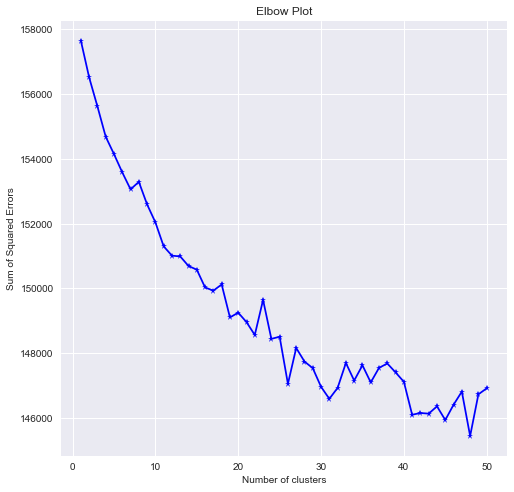

In [16]:
kmeans = clustering_factory(MiniBatchKMeans(random_state = 1))
kmeans_plot = kmeans.plot_elbow_curve(tfidf_matrix, 
                                      cluster_ranges = range(1, 51), 
                                      figsize = (8, 8))
#kmeans_plot.figure.savefig('1-elbow-plot.png')

Although the elbow plot suggests that using 40-50 clusters may lead to the best separation of our data, that is a large number of clusters. As we will want to use distance from cluster centroid as features in later predictive modeling, a large number of clusters will lead to a high-dimensional feature space. Let's begin with 20 clusters and see what vocabulary words make up the clusters and what the clusters look like.

In [134]:
num_clusters = 20
batch_size = round(0.05 * tfidf_matrix.shape[0])

km = MiniBatchKMeans(n_clusters = num_clusters,
                     batch_size = batch_size)

%time km.fit(tfidf_matrix)

CPU times: user 3.76 s, sys: 216 ms, total: 3.98 s
Wall time: 4.17 s


MiniBatchKMeans(batch_size=8177, compute_labels=True, init='k-means++',
        init_size=None, max_iter=100, max_no_improvement=10, n_clusters=20,
        n_init=3, random_state=None, reassignment_ratio=0.01, tol=0.0,
        verbose=0)

In [38]:
#joblib.dump(km, 'saved-models-info/clusters_km.pkl')
km_fit = joblib.load('saved-models-info/clusters_km.pkl')
clusters = km_fit.labels_.tolist()

To see which terms were used to cluster the grants, we can pull out the top ten words closest to the cluster centroids.

In [26]:
#sorted centroids
order_centroids = km_fit.cluster_centers_.argsort()[:, ::-1] 

num_words = 10

cluster_vocab = pd.DataFrame()
for i in range(num_clusters):
    centroid_words = []
    
    #for each cluster, get the words closest to 
    #the cluster center
    for idx in order_centroids[i, :num_words]:
        centroid_words.append(terms[idx])
    cluster_vocab['cluster ' + str(i)] = centroid_words

In [30]:
cluster_vocab

,cluster 0,cluster 1,cluster 2,cluster 3,cluster 4,cluster 5,cluster 6,cluster 7,cluster 8,cluster 9,cluster 10,cluster 11,cluster 12,cluster 13,cluster 14,cluster 15,cluster 16,cluster 17,cluster 18,cluster 19
0,alcohol,receptor,brain,hiv,liver,cell,age,patient,children,infect,parasit,heart,gene,imag,lung,diseas,cancer,protein,dna,pathogen
1,smoke,tumor,disord,infect,diseas,stem,sleep,treatment,obes,virus,iron,failur,express,kidney,injuri,mechan,breast,drug,genet,bacteri
2,tobacco,signal,neuron,1,hepat,tumor,relat,pain,intervent,vaccin,malaria,cardiac,diseas,method,inflamm,human,tumor,structur,genom,bacteria
3,cocain,activ,function,aid,fatti,cancer,cognit,improv,risk,immun,drug,diseas,human,develop,diseas,regul,prostat,diseas,human,antibiot
4,addict,target,memori,risk,alcohol,immun,diseas,effect,diabet,viral,infect,caus,regul,diseas,inflammatori,signal,cell,develop,diseas,infect
5,effect,regul,neural,intervent,cancer,diseas,declin,clinic,behavior,cell,diseas,death,mutat,patient,asthma,cell,therapi,target,sequenc,resist
6,abus,cell,circuit,drug,cirrhosi,regul,older,care,adolesc,host,caus,blood,develop,mri,pulmonari,develop,target,function,repair,host
7,drink,mechan,develop,prevent,metabol,develop,function,develop,effect,respons,develop,attack,genet,clinic,mechan,function,develop,biolog,mutat,diseas
8,behavior,therapeut,mechan,transmiss,caus,mechan,increas,therapi,prevent,human,human,lead,identifi,detect,airway,molecular,patient,enzym,cancer,immun
9,treatment,role,cognit,antiretrovir,develop,function,popul,diseas,social,develop,host,mechan,caus,improv,acut,pathway,treatment,membran,chromosom,human


We can immediately see that K-Means identified different research subjects, such as research regarding addiction and addictive substances (cluster 0) and HIV/AIDS research (cluster 3). This is confirmation that our unsupervised clustering was able to identify structure within our abstract data.

We will assign each cluster a label based on the top 10 vocabulary words closest to the cluster centroid. These labels will by definition be rather broad, but they do seem to capture general research categories.

In [37]:
cluster_labels = {
    0:'substance abuse/addiction',
    1:'cell signaling',
    2:'neuroscience',
    3:'hiv',
    4:'liver research',
    5:'cancer cell biology',
    6:'sleep/ageing',
    7:'clinical research',
    8:'child obesity/diabetes',
    9:'virology',
    10:'parasitology (malaria)',
    11:'cardiac research',
    12:'gene expression',
    13:'kidney research and imaging',
    14:'lung research',
    15:'human disease mechanisms',
    16:'cancer research',
    17:'drug development',
    18:'genetics and genomics',
    19:'bacteriology'
}

Let's add the cluster assignments and labels to our original dataframe.

In [39]:
phr['cluster'] = clusters
phr['cluster_labels'] = clusters
phr['cluster_labels'].replace(cluster_labels, inplace = True)

Save cluster assignments.

In [43]:
df_clusters = phr[['application_id', 'cluster', 'cluster_labels']]
df_clusters.to_csv('data/df_clusters.csv', index = False, compression = 'gzip')

In [100]:
phr['cluster_labels'].value_counts()

human disease mechanisms       21501
clinical research              20042
child obesity/diabetes         13130
neuroscience                   12686
cancer cell biology            11495
cancer research                10889
drug development                9071
gene expression                 7209
genetics and genomics           6244
virology                        6150
kidney research and imaging     6056
lung research                   5900
hiv                             5475
bacteriology                    5245
cell signaling                  4900
sleep/ageing                    4753
substance abuse/addiction       4607
cardiac research                4520
liver research                  2020
parasitology (malaria)          1639
Name: cluster_labels, dtype: int64

As expected, the more generic research clusters (e.g., human disease mechanisms and clinical research) are associated with the largest number of grants. It is probable that fitting more clusters would identify more detailed subgroups, particularly within these larger generic groups.

Plotting the distribution of funds by abstract cluster (grants with awarded funds greater than $1,000,000 not shown), we see that the peak of the funds by cluster are similar, although it looks like there may be some differences in the shape of the distributions.

/usr/local/lib/python3.6/site-packages/matplotlib/cbook.py:136: MatplotlibDeprecationWarning: The set_color_cycle attribute was deprecated in version 1.5. Use set_prop_cycle instead.
  warnings.warn(message, mplDeprecation, stacklevel=1)


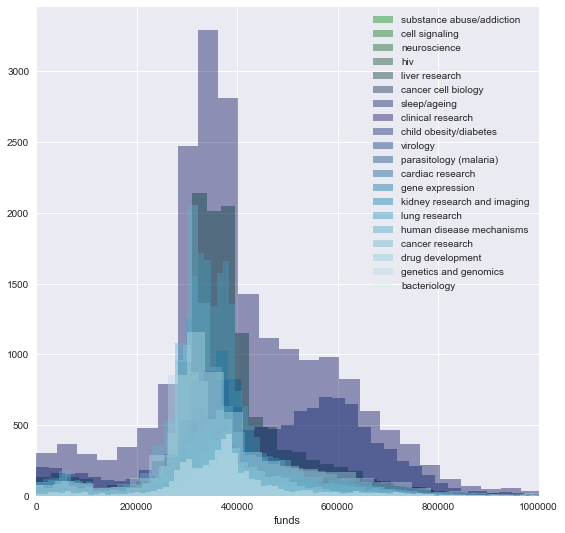

In [103]:
from cycler import cycler

num_colors = 20
cm = plt.get_cmap('ocean')

fig, ax = plt.subplots()
fig.set_size_inches(9, 9);

ax.set_color_cycle([cm(1.*i/num_colors) for i in range(num_colors)])
for i in range(20):
    _ = sns.distplot(phr.ix[phr['cluster'] == i]['funds'],
                     bins = 200, label = cluster_labels[i], kde = False)

_ = plt.legend()
_ = plt.xlabel('funds')
_ = plt.xlim(0, 1000000)

The large degree of overlap makes it difficult to resolve individual grant clusters. Let's visualize the data as violin plots.

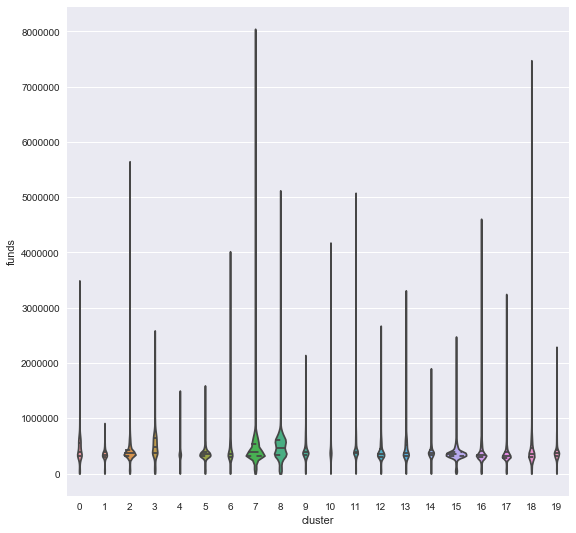

In [115]:
fig, ax = plt.subplots()
fig.set_size_inches(9, 9);
_ = sns.violinplot(x = 'cluster', y = 'funds', data = phr,
                  scale = 'count', inner = 'quartile')

The presence of extreme values makes it difficult to see the distributions clearly, but again we see there is a large degree of overlap.

Finally let's calculate the mean funding awarded per grant in each cluster.

In [109]:
phr.groupby('cluster_labels')['funds'].mean().sort_values(ascending = False)

cluster_labels
hiv                            499690.516712
child obesity/diabetes         482591.196116
cardiac research               434476.394248
kidney research and imaging    433162.161328
substance abuse/addiction      432384.346863
clinical research              431154.973406
virology                       423786.623415
genetics and genomics          419941.639174
sleep/ageing                   418262.839470
parasitology (malaria)         404944.325198
bacteriology                   396290.501239
lung research                  393594.535085
neuroscience                   386604.039808
gene expression                385651.485227
liver research                 369902.885149
cancer research                363345.147029
human disease mechanisms       359193.577089
cancer cell biology            356938.631492
cell signaling                 346228.160612
drug development               340855.400066
Name: funds, dtype: float64

## Cluster visualization

### Determining funding groups

Let's try and visualize our clusters based on abstract text. To get a sense of how well the clusters correspond to awarded funds, we will need to group the grants by amount of funding each grant received.

We already dropped any grants where funding information was not available; however, there are still grants where the awarded funds seem low. This [news release](https://nexus.od.nih.gov/all/2014/12/31/2014-by-the-numbers/) by the NIH states that the smallest amount awarded was over $200,000. We will use 100,000 as our cutoff value.

In [25]:
unusually_low = phr.loc[phr['funds'] < 100000]
print('There are {} grants where the awarded funds are less than $100,000.'\
     .format(len(unusually_low['funds'])))

There are 7098 grants where the awarded funds are less than $100,000.


It seems likely that these amounts were entered incorrectly. Let's drop these entries.

In [26]:
phr_filtered_funds = phr.drop(unusually_low.index)

We will now divide the grants into funding percentiles; using percentiles rather than mean +/- std guarantees that each funding group we define will have equal representation. First we need to determine the cutoff values for each percentile. We will then assign each grant to a particular funding group based on where the grant falls relative to the cutoff values.

In [29]:
percentiles = ['25%', '50%', '75%']

cutoffs = []
for percentile in percentiles:
    cutoffs.append(phr_filtered_funds.describe()['funds'][percentile])

print('Funding percentile cutoffs are ${}, ${} and ${}.'\
      .format(cutoffs[0], cutoffs[1], cutoffs[2]))

Funding percentile cutoffs are $319102.5, $371250.0 and $464929.5.


In [31]:
def split_into_percentiles(df, col1 = 'funds', col2 = 'funding_group', cutoffs = cutoffs):
    '''
    Split a continuous variable into percentiles/cutoff thresholds
    
    Inputs:
    df
    col1: column with continuous variable to be split
    col2: column of new group assignments
    cutoffs: sorted list of cutoff thresholds
    '''
    
    # <25th percentile
    df.loc[df[col1] < cutoffs[0], col2] = 'low'
    
    #25th-50th percentile
    df.loc[(df[col1] >= cutoffs[0]) & (df[col1] < cutoffs[1]), col2] = 'med-low'
    
    #50th-75th percentile
    df.loc[(df[col1] >= cutoffs[1]) & (df[col1] < cutoffs[2]), col2] = 'med-high'
    
    # >75th percentile
    df.loc[df[col1] >= cutoffs[2], col2] = 'high'
    
    return df

In [50]:
#copy funding information
phr_filtered_funds['funding_group'] = phr_filtered_funds['funds']
phr_filtered_funds = split_into_percentiles(phr_filtered_funds)

### Subsampling prior to dimensionality reduction

Our tfidf matrix has over 160,000 entries and over 1700 features (tfidf importance score). This is too large for most dimensionality reduction techniques to handle, therefore we will subsample our data. We want to preserve the relative cluster sizes, therefore we will randomly select 5% of each cluster.

In [53]:
subsamples = pd.DataFrame()
for cluster in range(num_clusters):
    #get size of each cluster
    total_group_size = phr_filtered_funds['cluster'].value_counts()[cluster]
    sample_size = int(round(0.05 * total_group_size))
    subsample = phr_filtered_funds.ix[phr_filtered_funds['cluster'] == cluster].sample(sample_size)
    subsamples = subsamples.append(subsample)

In [61]:
#subsamples.to_csv('subsamples_tsne.csv', index = False, compression = 'gzip')
subsamples = pd.read_csv('subsamples_tsne.csv', compression = 'gzip')

In [63]:
subsamples.shape

(8167, 21)

As we have a smaller document corpus, we need to vectorize with a smaller minimum number of documents to consider.

In [54]:
vect = TfidfVectorizer(max_df = 0.8, min_df = 50, stop_words = my_stops, 
                       lowercase = False, tokenizer = get_tokens_stems)
%time tfidf_subsample = vect.fit_transform(subsamples['phr_cleaned'].tolist())

CPU times: user 11.8 s, sys: 49.5 ms, total: 11.9 s
Wall time: 12.1 s


In [56]:
tfidf_matrix.shape
tfidf_subsample.shape

(163532, 1745)

(7826, 1107)

### Dimensionality reduction techniques to visualize clusters
t-distributed stochastic neighbor embedding ([t-SNE](https://en.wikipedia.org/wiki/T-distributed_stochastic_neighbor_embedding)) is a non-linear dimensionality technique that is a useful algorithm for visualizing high-dimensional data. We will use t-SNE to map our clusters to two-dimensions in order to visualize how well K-Means clustered the abstracts. The learning rate of t-SNE is an important parameter that can determine the best cluster separation and sklearn recommends a value between 100 and 1000.

In [64]:
learning_rates = [100, 250, 500, 750, 1000]
fitted_tsnes = []

for rate in learning_rates:
    tsne = TSNE(learning_rate = rate)
    fitted_tsnes.append(tsne.fit_transform(tfidf_subsample.toarray()))

In [65]:
#joblib.dump(fitted_tsnes, 'fitted_tsnes.pkl')
fitted_tsnes = joblib.load('fitted_tsnes.pkl')

['fitted_tsnes.pkl']

In order to visualize all 20 clusters, we need to generate 20 colors that are as different as possible so the clusters are as distinct as possible. The code to accomplish this was downloaded from [here](https://gist.github.com/adewes/5884820).

In [57]:
import random
import generate_random_color as gen

colors = []
for i in range(20):
    colors.append(gen.generate_new_color(colors, pastel_factor = 0.9))

Match each color with a cluster label.

In [58]:
cluster_colors = {}
for label, color in zip(subsamples['cluster_labels'].unique(), colors):
    cluster_colors[label] = color

Sort the cluster labels alphabetically so the legend will be easier to read.

In [59]:
hue_order = []
for _, v in cluster_labels.items():
    hue_order.append(v)
hue_order = sorted(hue_order)

The clusters are best separated when the learning rate is 1000; for brevity only these results are plotted.

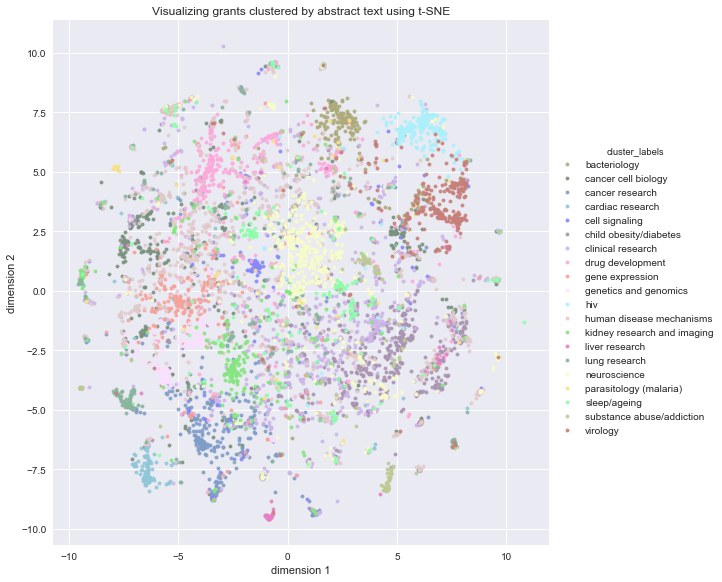

In [70]:
tsne_df = pd.DataFrame(fitted_tsnes[-1], columns = ['dimension 1', 'dimension 2'], index = subsamples.index)
tsne_df['cluster_labels'] = subsamples['cluster_labels']

ax = sns.lmplot('dimension 1', 'dimension 2', tsne_df, hue = 'cluster_labels',
                hue_order = hue_order,
                fit_reg = False, palette = cluster_colors, 
                size = 8, scatter_kws = {'alpha':0.9, 's':15})
_ = ax.set(title = 'Visualizing grants clustered by abstract text using t-SNE')

The sklearn documentation on t-SNE recommends performing an upstream dimensionality reduction technique such as PCA to reduce the number of dimensions to around 50 prior to using t-SNE to get better cluster visualization.

In [66]:
pca = PCA(n_components = 50)
reduced = pca.fit_transform(tfidf_subsample.toarray())
print('{:.2%}'.format(pca.fit(tfidf_subsample.toarray()).explained_variance_ratio_.cumsum()[-1]) + \
      ' of the variance is explained by the first ' + str(50) + ' components.')

21.45% of the variance is explained by the first 50 components.


In [67]:
reduced_tsnes = []
for rate in learning_rates:
    tsne = TSNE(learning_rate = rate)
    reduced_tsnes.append(tsne.fit_transform(reduced))

In [68]:
#joblib.dump(reduced_tsnes, 'reduced_tsnes.pkl')
reduced_tsnes = joblib.load('reduced_tsnes.pkl')

['reduced_tsnes.pkl']

After fitting t-SNE on our PCA-reduced data, the learning rate that gave the most distinctly separated clusters was a learning rate of 750, which is shown below.

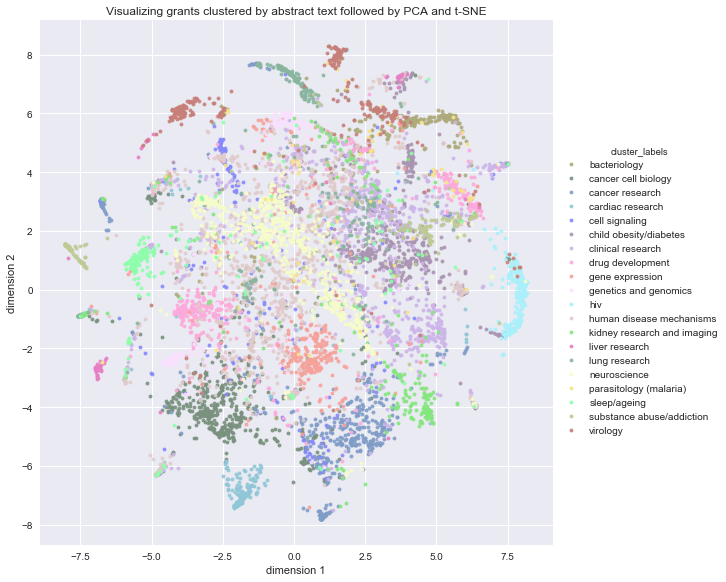

In [74]:
tsne_df = pd.DataFrame(reduced_tsnes[-2], columns = ['dimension 1', 'dimension 2'], 
                       index = subsamples.index)
tsne_df['cluster_labels'] = subsamples['cluster_labels']

tsne_fig = sns.lmplot('dimension 1', 'dimension 2', tsne_df, hue = 'cluster_labels',
                      hue_order = hue_order,
                      fit_reg = False, palette = cluster_colors, 
                      size = 8, scatter_kws = {'alpha':0.9, 's':15})

tsne_fig = plt.title('Visualizing grants clustered by abstract text followed by PCA and t-SNE')
#tsne_fig.figure.savefig('3-pca-tsne.png')

We can see pretty distinct clusters (although some are broken into multiple clusters), again suggesting our K-Means clustering did a relatively good job separating grants based on abstract text.

## Predicting funding group based on grant abstract

For our initial model, we will attempt to predict which funding percentile group a grant falls into based on tf-idf of the abstracts. Although we will lose some information by grouping grants in this manner rather than running a regression, multinomial Naive Bayes classifiers are good default models that can handle high-dimensional text data.
They can also be trained very quickly and will give us a sense of baseline predictions based purely on abstract text data. Furthermore, we will use the lime package (see below) to explain individual predictions, and lime as of 2017/06 is more robust with classifiers than regression models. Finally, the loss of information that following grouping of grants based on funding percentiles will be relatively low, as most grants received funding in a narrow range (see histogram above).

In [76]:
Xtrain_nb, Xtest_nb, ytrain_nb, ytest_nb = train_test_split(phr_filtered_funds['phr_cleaned'].values, 
                                                            phr_filtered_funds['funding_group'].values, 
                                                            test_size = 0.25)

In [77]:
%time tfidf_train = vectorizer.fit_transform(Xtrain_nb)
%time tfidf_test = vectorizer.transform(Xtest_nb)

CPU times: user 2min 57s, sys: 792 ms, total: 2min 58s
Wall time: 3min 1s
CPU times: user 56.3 s, sys: 133 ms, total: 56.4 s
Wall time: 56.6 s


In [78]:
nb = MultinomialNB(alpha = 0.01)
nb.fit(tfidf_train, ytrain_nb)
nb_pred = nb.predict(tfidf_test)

MultinomialNB(alpha=0.01, class_prior=None, fit_prior=True)

In [79]:
print('Multinomial Naive Bayes trained on abstract text data results in an F1 score of {0:.3f}.'\
     .format(f1_score(ytest_nb, nb_pred, average = 'weighted')))

Multinomial Naive Bayes trained on abstract text data results in an F1 score of 0.434.


Let's see how well our model is predicting each class overall.

In [80]:
predictions = pd.DataFrame({'true':ytest_nb, 'pred':nb_pred})
predictions['correct_pred'] = predictions['pred'] == predictions['true']
predictions['correct_pred'].value_counts(normalize = True)

False    0.560766
True     0.439234
Name: correct_pred, dtype: float64

In [81]:
predictions.groupby('true')['correct_pred'].value_counts(normalize = True)

true      correct_pred
high      True            0.598010
          False           0.401990
low       False           0.554649
          True            0.445351
med-high  False           0.623658
          True            0.376342
med-low   False           0.660976
          True            0.339024
Name: correct_pred, dtype: float64

Finally, we can use [scikit-plot](https://github.com/reiinakano/scikit-plot) to plot the confusion matrix to see how our multinomial Naive Bayes is performing for each class.

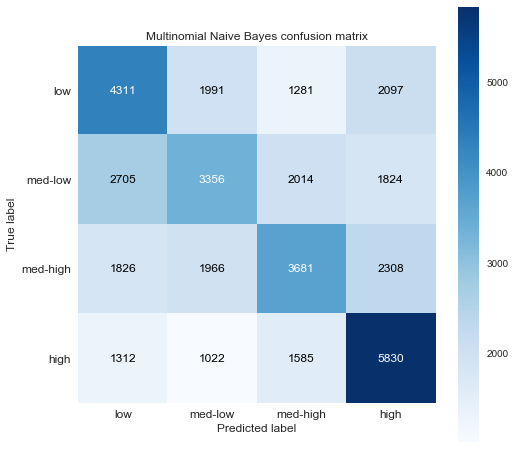

In [83]:
nb_confusion = skplt.plot_confusion_matrix(y_true = ytest_nb, y_pred = nb_pred,
                                           labels = ['low', 'med-low', 'med-high', 'high'],
                                           figsize = (8, 8), text_fontsize = 'large', 
                                           title = 'Multinomial Naive Bayes confusion matrix')

#nb_confusion.figure.savefig('4-nb-confusion.png')

Given that this is a naive model trained only on abstract text data, our predictions are relatively good. We see that the best predictions by far are for highly funded grants, but the model predicts the true class label for the other funding groups at higher frequencies than the incorrect classes. Furthermore, when our naive classifier mis-classified grants, it tended to predict the adjacent funding group at higher frequencies than a more extreme funding group. The major exception is for grants our model predicted were highly funded but were actually in the low funding group. It is possible that the funding information of some of the grants in this group were also entered incorrectly, as we set a low cutoff value (100,000) for grants that had unusually low funds.

### Model interpretation

To get a sense of how our multinomial Naive Bayes is classifying grants, we will use the [lime](https://github.com/marcotcr/lime) package to 'explain' individual predictions. For some reason lime does not handle response variables coded as strings very well, as the printed prediction probabilities do not match up with the actual predicted class. Therefore we will have to re-code response variables as integers.

In [84]:
labels_to_num = {
        'low':0,
        'med-low':1,
        'med-high':2,
        'high':3
    }

predictions = predictions.replace(labels_to_num)

In [105]:
def arrays_for_exp(array, dict_ = labels_to_num):
    '''
    Convert arrays with strings to int
    '''
    exp_array = array.copy()
    for k, v in dict_.items():
        exp_array[exp_array == k] = v
    return exp_array.astype(int)

Create new arrays and re-train our model.

In [106]:
exp_ytrain = arrays_for_exp(ytrain_nb)
exp_ytest = arrays_for_exp(ytest_nb)

In [108]:
nb_exp = MultinomialNB(alpha = 0.01)
nb_exp.fit(tfidf_train, exp_ytrain)

MultinomialNB(alpha=0.01, class_prior=None, fit_prior=True)

In [30]:
from lime import lime_text
from sklearn.pipeline import make_pipeline
from lime.lime_text import LimeTextExplainer

In [114]:
def explain_prediction(idx, X_test = Xtest_nb, tfidf_test = tfidf_test, 
                       y_test = exp_ytest, nb = nb_exp, vectorizer = vectorizer):
    
    '''
    Use lime package's explainer class to explain
    how grant was classified into a funding category
    based on abstract text.
    '''
    
    pipeline = make_pipeline(vectorizer, nb_exp)
    class_names = ['low', 'med-low', 'med-high', 'high']
    
    explainer = LimeTextExplainer(class_names = class_names)
    exp = explainer.explain_instance(X_test[idx], 
                                     pipeline.predict_proba, 
                                     num_features = 6, 
                                     labels = [0, 1, 2, 3])
    
    #label number of predicted class
    label_num = int(nb.predict(tfidf_test[idx]).reshape(1, -1)[0, 0])
    
    print('Grant number: {}'.format(idx))
    print('Predicted class: {}'.format(class_names[label_num]))
    print('True class: {}'.format(class_names[int(y_test[idx])]))
    
    exp.show_in_notebook(text = False)
    exp.show_in_notebook(text = X_test[idx], labels = (label_num,))

Let's look at one instance of each funding group (class) where our model correctly predicted the response class and one instance where the prediction was incorrect.

In [112]:
indices = []
groups = sorted(predictions['true'].unique().tolist())
for group in groups:
    for boolean in [True, False]:
        sample = predictions.ix[(predictions['true'] == group) & 
                                (predictions['correct_pred'] == boolean)].sample(1)
        indices.append(sample.index[0])

In [115]:
for idx in indices:
    explain_prediction(idx)

/usr/local/Cellar/python3/3.6.0/Frameworks/Python.framework/Versions/3.6/lib/python3.6/re.py:212: FutureWarning: split() requires a non-empty pattern match.
  return _compile(pattern, flags).split(string, maxsplit)


Grant number: 5903
Predicted class: low
True class: low


Grant number: 11099
Predicted class: med-low
True class: low


Grant number: 26913
Predicted class: med-low
True class: med-low


Grant number: 18192
Predicted class: med-high
True class: med-low


Grant number: 35926
Predicted class: med-high
True class: med-high


Grant number: 36047
Predicted class: low
True class: med-high


Grant number: 21560
Predicted class: high
True class: high


Grant number: 13997
Predicted class: med-high
True class: high


## Predicting the amount of funding a grant was awarded

In our initial analysis we used a simple multinomial Naive Bayes model trained on our abstract tfidf matrix to predict a grant's funding group. Multinomial Naive Bayes is often used for text classifications; however, we want to know if incorporating other information regarding NIH grants results in better predictions. Specifically, we would ideally like to perform regression, as our response variable is in reality a continuous variable. 


### Preparing design matrix
We need to prepare a separate design matrix to train regression models. Due to dimensionality concerns we will not directly use our tf-idf matrix. Instead, we will use the distance of each grant from the center of the 20 clusters identified by K-Means. As we want to measure distance of each observation (grant) from the K-Means cluster center, we will use the standard Euclidean distance.

In [46]:
from scipy.spatial.distance import cdist

#default is Euclidean distance
dist = cdist(tfidf_matrix.toarray(), km_fit.cluster_centers_)
dist.shape

(163532, 20)

In addition to these distance measurements, we will also include the following potentially useful features:

* **application_type:** Are different types of applications (new, renewal, etc.) awarded more or fewer funds?
* **fy:** Was a particular funding year associated with higher or lower funding?
* **study_section:** Do certain study sections award more or fewer funds than other sections?
* **support_year:** Does a grant in its y year of funding receive more or less funding than in another year?
* **pi_ids:** Do certain PIs get highly funded grants relative to other PIs?
* **num_pis:** Do grants with more than one PI receive more or less funding than grants with a single PI?
* **application_id** for identification purposes
* **org_duns:** Are certain organizations associated with more or less well-funded grants? Organizations are identified via a [DUNS number](https://en.wikipedia.org/wiki/Data_Universal_Numbering_System), and this information is stored in [pi_info.csv](https://github.com/yuwie10/nih-awards/blob/master/pi_info.csv).

In [47]:
df_modeling = pd.DataFrame(dist, columns = ['dist_' + str(i) for i in range(20)])

cols = ['application_type', 'fy', 'study_section', 
       'support_year', 'pi_ids', 'num_pis', 'funds', 'application_id']

for col in cols:
    df_modeling[col] = phr[col].tolist()

In [147]:
print('~{0:.1f}% of grants have more than 1 associated PI.'\
      .format((1 - phr['num_pis'].value_counts(normalize = True)[1.0]) * 100))

~13.4% of grants have more than 1 associated PI.


In our original dataframe, if multiple PIs were associated with a single grant, then each PI was listed separately. At the beginning of our analysis, we combined these rows such that a single grant only appears once; however, information about individual PIs on these grants was lost. We will therefore also include the number of PIs as a feature to gain back some of this information.

Next we need to drop grants with unusually low funds and add funding group information.

In [51]:
df_modeling.drop(df_modeling.loc[df_modeling['funds'] < 100000].index, inplace = True)
df_modeling['funding_group'] = phr_filtered_funds['funding_group'].tolist()

To get the organization DUNS information, we have to load [pi_info.csv](https://github.com/yuwie10/nih-awards/blob/master/pi_info.csv) and add the org_duns column to the dataframe with the features we will use to train our model. Although one principal investigator (PI) can be associated with multiple organizations due to either joint appointments or a PI moving, for simplicity we will select the first organization the PI is associated with.

In [53]:
duns = pd.read_csv('data/pi_info.csv', compression = 'gzip',
                   usecols = ['pi_ids', 'org_duns'], dtype = str)

duns.drop_duplicates('pi_ids', inplace = True)
df_modeling = df_modeling.merge(duns, on = 'pi_ids', how = 'left')

Let's check for missing values.

In [126]:
df_modeling.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 156434 entries, 0 to 156433
Data columns (total 30 columns):
dist_0              156434 non-null float64
dist_1              156434 non-null float64
dist_2              156434 non-null float64
dist_3              156434 non-null float64
dist_4              156434 non-null float64
dist_5              156434 non-null float64
dist_6              156434 non-null float64
dist_7              156434 non-null float64
dist_8              156434 non-null float64
dist_9              156434 non-null float64
dist_10             156434 non-null float64
dist_11             156434 non-null float64
dist_12             156434 non-null float64
dist_13             156434 non-null float64
dist_14             156434 non-null float64
dist_15             156434 non-null float64
dist_16             156434 non-null float64
dist_17             156434 non-null float64
dist_18             156434 non-null float64
dist_19             156434 non-null float64
applicati

First let's convert support_year and num_pis to integers so they are represented as discrete, rather than continuous, variables.

In [38]:
for col in ['support_year', 'num_pis']:
    df_modeling[col] = df_modeling[col].astype(int)

### High-cardinal variables
A small number of grants are missing study section information or organization DUNS numbers. As these missing values represent less than 1% of the grants, we can simply impute these missing values. Prior to imputation, we will need to transform the study section, PI ID and organization DUNS variables, as all three are high-cardinal variables. High-cardinality refers to categorical variables with many distinct levels, which if dummy encoded could quickly blow-up our feature space. As can be seen below, these three variables have a very large number of distinct values.

In [153]:
card_cols = ['study_section', 'pi_ids', 'org_duns']
num_unique = []
for col in card_cols:
    num_unique.append(len(df_modeling[col].unique()))

print('There are {} unique study sections, {} unique PIs and {} unique organizations in the dataset.'\
     .format(num_unique[0], num_unique[1], num_unique[2]))

There are 250 unique study sections, 28971 unique PIs and 1067 unique organizations in the dataset.


The pi_ids variable could be particularly problematic due to its extremely high-cardinality.

In [154]:
#counts number of times a unique PI ID is present
#in the dataset
counts_ids = df_modeling['pi_ids'].value_counts()

#how many PI IDs are represented 
#10 or fewer times in the dataset
low_counts = []
for i in range(1, 11):
    low_counts.append(len(counts_ids[counts_ids == i]))

sum_ = sum(low_counts)
per = sum_ / len(counts_ids) * 100

print('{0:} or ~{1:.1f}% of unique PI IDs only occur 10 or fewer times in the grants dataset.'\
      .format(sum_, per))

26238 or ~90.6% of unique PI IDs only occur 10 or fewer times in the grants dataset.


If we include pi_ids as a feature, we will be dealing with a very sparse matrix. We will therefore drop pi_ids as a feature and transform study_section and org_duns to continuous ones to prevent problems of high-dimensionality when fitting our model. To prevent data leakage we will first split our data into train and test sets prior to any transformations.

In [40]:
df_modeling.drop('pi_ids', axis = 1, inplace = True)

In [41]:
response_cols = ['funds', 'funding_group']
feature_cols = [col for col in df_modeling if col not in response_cols]

model_xtrain, _, model_ytrain, _ = train_test_split(df_modeling[feature_cols],
                                                    df_modeling[response_cols],
                                                    test_size = 0.25, 
                                                    random_state = 42)

Let's merge the training sets back together and check the number of distinct values in the high-cardinal variables.

In [143]:
model_train = pd.concat([model_xtrain, model_ytrain], axis = 1)
card_cols.remove('pi_ids')
lens = []
for col in card_cols:
    lens.append(len(model_train[col].unique()))

In [144]:
print('There are {} unique study sections and {} unique DUNS numbers represented in the training set.'\
     .format(lens[0], lens[1]))

There are 249 unique study sections and 1031 unique DUNS numbers represented in the training set.


Although some values of study_section and org_duns are not represented in the training set, they represent a low proportion of the total number of unique values. Therefore we can fill any unseen values in the test set with the mean.

Let's use the [supervised ratio](kdnuggets.com/2016/08/include-high-cardinality-attributes-predictive-model.html) (SR) technique to transform our high-cardinal variables to continuous ones. As we have 4 response categories (funding groups), we will have to create 4 columns representing the SR of each distinct value per response category.

In [43]:
study_sect_sr = nih.sr_transformation(model_train, 'study_section', 'funding_group')
duns_sr = nih.sr_transformation(model_train, 'org_duns', 'funding_group')

One concern with SR transformation of cardinal variables is when a particular value of the cardinal variable does not appear in all the response categories, e.g., a particular DUNS number may only be associated with grants that were highly funded. Let's take a look at the proportion of 0s in each funding group.

In [142]:
print('Proportion of 0s in each funding category by high-cardinal variable:')
for df, name in zip([study_sect_sr, duns_sr], ['study sections:', 'DUNS #s:']):
    print()
    print(name)
    print()
    for col in df.columns:
        print(col + ': ' + str((df[col] == 0).sum() / len(df)))

Proportion of 0s in each funding category by high-cardinal variable:

study sections:

study_section: 0.0
med-low_sect: 0.0362903225806
med-high_sect: 0.0282258064516
high_sect: 0.0241935483871

DUNS #s:

org_duns: 0.0
med-low_duns: 0.136893203883
med-high_duns: 0.100970873786
high_duns: 0.125242718447


In each funding group, there are a number of study sections and a large number of organizations (represented as DUNS numbers) that appear in fewer than all four funding groups. This could either be due to the study section or organization being associated with very few grants and is therefore associated with a given funding group by chance alone, or because the study section or organization truly has a high likelihood of being associated with a particular funding group(s). Let's check how often a study section or organization that falls into 3 or fewer funding groups appears in our dataset.

In [44]:
def find_zero_rows(df, value = 0):
    '''
    Finds the rows where at least one entry is equal to value (default 0).
    '''
    zero_rows = []
    for index, row in df.iterrows():
        for col in df.columns:
            if row[col] == value:
                zero_rows.append(index)
    
    return list(set(zero_rows))

def count_how_often(df1, df2, col):
    '''
    Output: dict where key = index of entry with zero value and 
    value = # times index appears in dataset
    '''
    
    zero_rows = find_zero_rows(df1)
    how_often = {}
    for row in zero_rows:
        len_ = len(df2.ix[df2[col] == row])
        how_often[row] = len_
    
    return how_often

In [141]:
how_often_duns = count_how_often(duns_sr, df_modeling, col = 'org_duns')
how_often_sect = count_how_often(study_sect_sr, df_modeling, col = 'study_section')

print('There are {} organizations and {} study sections associated with 3 or fewer funding groups.'\
     .format(len(how_often_duns), len(how_often_sect)))

There are 645 organizations and 17 study sections associated with 3 or fewer funding groups.


We have several choices with how we deal with these entries. The first is to leave the transformed variables as they are and simply watch out for overfitting to these variables. We could also include a count variable of how often the instance appears in the dataset. Finally, we could treat low count instances as missing values and impute the normalized mean of each funding group.

For the study_section variable, we will simply include the SR transformed columns. There are relatively few instances that are not represented by all funding groups, so our model's performance should not be affected too severely. Furthermore, it is conceivable that certain study sections do tend to bias towards awarding a set amount of funds.

For the org_duns variable, let's impute the normalized mean of each column for those rows where all the instances were associated with only one funding group. We will not add a column with the org_duns counts as this does not seem a particularly useful feature and we want to limit the number of features as much as possible

In [47]:
#setting value = 1 finds rows where 
#only 1 funding category is represented
zero_row_duns = find_zero_rows(duns_sr, value = 1)

norm_means = duns_sr.mean() / duns_sr.mean().sum()

#also get normalized mean for study sections
means_sect = study_sect_sr.mean() / study_sect_sr.mean().sum()

for row in zero_row_duns:
    duns_sr.loc[row] = norm_means

To prevent aliasing of our transformed variables, let's drop the 'low' columns and re-name the remaining columns.

In [48]:
duns_sr.drop('low', axis = 1, inplace = True)
study_sect_sr.drop('low', axis = 1, inplace = True)

duns_sr.columns = [str(col) + '_duns' for col in duns_sr.columns]
study_sect_sr.columns = [str(col) + '_sect' for col in study_sect_sr.columns]

Join the SR transformed variables with the original dataframe and drop the original non-transformed variables.

In [49]:
#rename index to column name
duns_sr.index.names = ['org_duns']
study_sect_sr.index.names = ['study_section']

duns_sr.reset_index(inplace = True)
study_sect_sr.reset_index(inplace = True)

df_modeling = df_modeling.merge(duns_sr, on = 'org_duns', how = 'left')
df_modeling = df_modeling.merge(study_sect_sr, on = 'study_section', how = 'left')

#save duns and study section info for future reference
duns_sect = df_modeling[['study_section', 'org_duns']]
duns_sect.to_csv('data/duns_sect.csv', index = False, compression = 'gzip')

df_modeling.drop(['study_section', 'org_duns'], axis = 1, inplace = True)

In [140]:
df_modeling.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 156434 entries, 0 to 156433
Data columns (total 33 columns):
dist_0              156434 non-null float64
dist_1              156434 non-null float64
dist_2              156434 non-null float64
dist_3              156434 non-null float64
dist_4              156434 non-null float64
dist_5              156434 non-null float64
dist_6              156434 non-null float64
dist_7              156434 non-null float64
dist_8              156434 non-null float64
dist_9              156434 non-null float64
dist_10             156434 non-null float64
dist_11             156434 non-null float64
dist_12             156434 non-null float64
dist_13             156434 non-null float64
dist_14             156434 non-null float64
dist_15             156434 non-null float64
dist_16             156434 non-null float64
dist_17             156434 non-null float64
dist_18             156434 non-null float64
dist_19             156434 non-null float64
applicati

There were some grants in the original dataset from NIH where the DUNS number and/or study section was not listed. Let's impute these missing values with the mean of each column.

In [50]:
cols_to_fill = [col for col in list(df_modeling) if col.endswith('duns')] + \
[col for col in list(df_modeling) if col.endswith('sect')]

means = norm_means.drop('low').tolist() + means_sect.drop('low').tolist()

for col, mean in zip(cols_to_fill, means):
    df_modeling[col] = df_modeling[col].fillna(mean)

We will save our dataframe for future reference.

In [15]:
#df_modeling.to_csv('data/df_modeling.csv', index = False, compression = 'gzip')
df_modeling = pd.read_csv('data/df_modeling.csv', 
                          compression = 'gzip', 
                          dtype = {'application_id':object,
                                   'funding_group':object, 
                                   'application_type':object,
                                   'fy':object,
                                   'support_year':int,
                                   'num_pis':int})

### Final train and test matrices

Let's re-split our data into train and test sets to use for training our final models. We will seed the train_test_split with the same random state as we did previously so that observations used in transforming the high-cardinal variables do not end up in the test set and result in data leakage.

In [17]:
#re-specify feature columns
feature_cols = [col for col in df_modeling if col not in response_cols]

In [18]:
xtrain_df, xtest_df, ytrain_df, ytest_df = train_test_split(df_modeling[feature_cols],
                                                            df_modeling[response_cols],
                                                            test_size = 0.25, 
                                                            random_state = 42)

In [19]:
#save application_id columns for identification purposes
app_id_train = xtrain_df['application_id']
app_id_test = xtest_df['application_id']

xtrain_df.drop('application_id', axis = 1, inplace = True)
xtest_df.drop('application_id', axis = 1, inplace = True)

Finally, we will one-hot encode the remaining categorical variables for sklearn.

In [20]:
xtrain_df = pd.get_dummies(xtrain_df, drop_first = True)
xtest_df = pd.get_dummies(xtest_df, drop_first = True)

In [21]:
xtrain_df.shape, ytrain_df.shape
xtest_df.shape, ytest_df.shape

((117325, 44), (117325, 2))

((39109, 44), (39109, 2))

### Training regression models to predict amount of funds awarded
Now that we have our train and test sets, we can train our regression models. We will start with random forests, as they can handle a relatively large number of features (as long as they are not too sparesely represented) and non-linear relationships.

In [22]:
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import r2_score

In [23]:
X_train = xtrain_df.as_matrix()
y_train = ytrain_df['funds'].as_matrix()
X_test = xtest_df.as_matrix()
y_test = ytest_df['funds'].as_matrix()

In [153]:
rf = RandomForestRegressor(n_estimators = 500, 
                           n_jobs = -1, 
                           random_state = 2)
rf.fit_transform(X_train, y_train)

/usr/local/lib/python3.6/site-packages/sklearn/utils/deprecation.py:70: DeprecationWarning: Function transform is deprecated; Support to use estimators as feature selectors will be removed in version 0.19. Use SelectFromModel instead.
  warnings.warn(msg, category=DeprecationWarning)


array([[ 1.01611405,  0.97016913,  1.0007423 , ...,  0.27178218,
         0.15012107,  0.        ],
       [ 1.02288582,  1.00370963,  1.00994123, ...,  0.16548463,
         0.32868612,  0.        ],
       [ 1.01295242,  0.98996063,  1.00404201, ...,  0.18771331,
         0.12875536,  0.        ],
       ..., 
       [ 1.01899717,  1.01980219,  0.9916759 , ...,  0.27956989,
         0.20558376,  1.        ],
       [ 1.0051002 ,  0.98141018,  0.96666582, ...,  0.42142857,
         0.04552129,  0.        ],
       [ 1.01792727,  0.98919167,  1.01018605, ...,  0.16713615,
         0.16666667,  0.        ]])

In [14]:
#joblib.dump(rf, 'rf_naive.pkl')
rf = joblib.load('rf_naive.pkl')

In [24]:
rf_pred = rf.predict(X_test)
print('The R squared value of the naive random forest model is {0:.3f}, implying\
 ~{1:.1%} of the variance is expalined by our model.'\
      .format(r2_score(y_test, rf_pred),
             r2_score(y_test, rf_pred)))

The R squared value of the naive random forest model is 0.657, implying ~65.7% of the variance is expalined by our model.


Let's compare the predictions of the naive random forest to our multinomial Naive Bayes trained on text data. To do so let's convert the predicted funds to predicted funding groups.

In [32]:
funding_groups_rf = pd.DataFrame({'rf_pred':rf_pred,
                                 'funds':y_test,
                                 'pred_fund_group':rf_pred,
                                 'funding_group':y_test,
                                 'application_id':app_id_test})

for col1, col2 in zip(['rf_pred', 'funds'], ['pred_fund_group', 'funding_group']):
    funding_groups_rf = split_into_percentiles(funding_groups_rf,
                                              col1, col2)

In [35]:
funding_groups_rf.to_csv('data/pred_funding_groups.csv', 
                         index = False,
                        compression = 'gzip')

In [135]:
print('The F1 score from the naive random forest trained on grant features is {0:.3f}, \
compared to {1:.3f}, the F1 score from multinomial Naive Bayes trained on abstract text.'\
     .format(f1_score(funding_groups_rf['funding_group'],
                     funding_groups_rf['pred_fund_group'],
                     average = 'weighted'),
            f1_score(ytest_nb, nb_pred, average = 'weighted')))

The F1 score from the naive random forest trained on grant features is 0.726, compared to 0.438, the F1 score from multinomial Naive Bayes trained on abstract text.


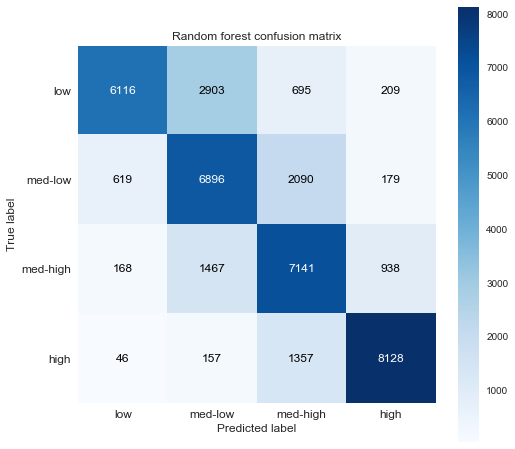

In [117]:
rf_confusion = skplt.plot_confusion_matrix(y_true = funding_groups_rf['funding_group'], 
                                           y_pred = funding_groups_rf['pred_fund_group'],
                                           labels = ['low', 'med-low', 'med-high', 'high'],
                                           figsize = (8, 8), text_fontsize = 'large', 
                                           title = 'Random forest confusion matrix')

#rf_confusion.figure.savefig('5-rf-confusion.png')

These predictions are an improvement from a model trained only on abstract text data. We could likely improve our prediction even further by tuning hyperparameters. To do this we need to perform k-fold cross-validation in order to prevent overfitting.

In [69]:
from sklearn.model_selection import KFold
from sklearn.model_selection import cross_val_score

We have a large training sample, therefore the choice of k in k-fold cross-validation should not matter too much, as the number of combinations of train/validation splits increases and the risk of duplicates decreases. We will therefore start with 10 splits, which is the standard default value of k.

In [72]:
cv = KFold(n_splits = 10, random_state = 50)

In [273]:
%time cross_val_score(rf, X_train, y_train, cv = cv)

CPU times: user 7h 10min 33s, sys: 3min 1s, total: 7h 13min 34s
Wall time: 2h 1min 25s


array([ 0.654456  ,  0.72302788,  0.66884503,  0.71940591,  0.68801332,
        0.65705131,  0.67290154,  0.70151281,  0.65820437,  0.70920705])

The total run time was around 2 hours, not 7, because we set n_jobs = -1 when we specified parameters in our random forest; however, this is still a significant amount of time to train our model. As our predictions are already pretty good, for time and computational power constraints we will not further tune hyperparameters.

An alternative model to random forests that can result in increased accuracy and can be trained more rapidly is gradient boosted trees implemented via XGBoost.

In [138]:
from xgboost import XGBRegressor

In [139]:
xgb = XGBRegressor(n_estimators = 500)
xgb = xgb.fit(X_train, y_train)
xgb_pred = xgb.predict(X_test)

In [140]:
print('The R squared value of the naive gradient boosted tree model is {0:.3f}.'\
      .format(r2_score(y_test, xgb_pred)))

The R squared value of the naive gradient boosted tree model is 0.330.


The naive gradient boosted tree regressor performs far more poorly on this dataset than random forests. One possibility is that the boosted tree is overfitting the training data due to the high-dimensionality of our data. It is unlikely that even after tuning the former will outperform random forests on these data.

Let's identify which features our random forest model was using for the prediction task. The code to convert feature_importances to a dataframe with feature names and importance scores can be found [here](https://github.com/yuwie10/who-voted/blob/master/who_voted_functions.py).

In [118]:
import importlib.util

script = 'who_voted_functions.py'
path = '/Users/yuwenwu/who-voted/who_voted_functions.py'

spec = importlib.util.spec_from_file_location(script, path)
wv = importlib.util.module_from_spec(spec)
spec.loader.exec_module(wv)

In [119]:
feature_cols.remove('application_id')
categ_cols = ['fy', 'application_type']
cont_cols = [col for col in feature_cols if col not in categ_cols]

important_features = wv.find_important_features(xtest_df, rf, categ_cols, cont_cols)

To make the features easier to interpret, let's replace the distance variable names (which represent the distance of each grant from the K-means cluster centroid) with the corresponding cluster label.

In [120]:
important_features.reset_index(drop = True, inplace = True)
for idx, feature in important_features['features'].iteritems():
    if feature.startswith('dist_'):
        important_features = important_features.replace(to_replace = feature, 
                                                        value = int(feature[5:]))

important_features = important_features.replace(cluster_labels)

Let's also combine the variables related to the DUNS number and study section of the grant.

In [121]:
def combine_card_scores(df, endswith, new_col, col1 = 'features', col2 = 'importance'):
    '''
    Combines the importance scores of transformed cardinal variables.
    '''
    scores = []
    for idx, feature in df[col1].iteritems():
        if feature.endswith(endswith):
            
            #append importance score
            scores.append(df.loc[idx, col2])
            
            #removes row with feature from original df
            df = df[df[col1] != feature]
    
    sum_scores = sum(scores)
    new_row = pd.DataFrame([[new_col, sum_scores]], columns = [col1, col2])
    df = df.append(new_row)
    
    return df.sort_values('importance', ascending = False)

In [122]:
important_features = combine_card_scores(important_features, '_sect', 'study_section')
important_features = combine_card_scores(important_features, '_duns', 'org_duns')

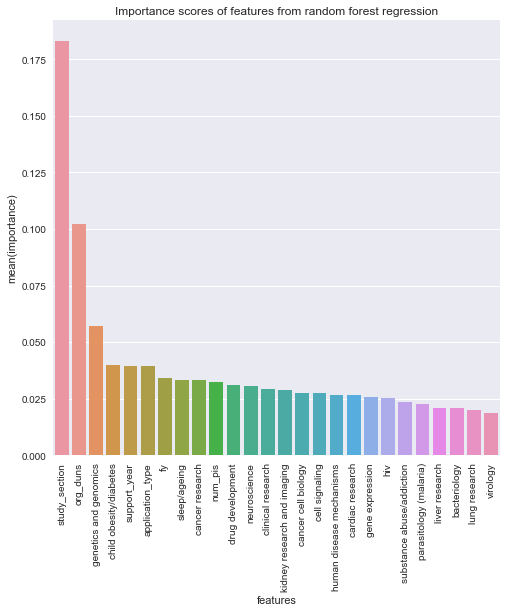

In [123]:
fig, ax = plt.subplots()
fig.set_size_inches(8, 8);
rf_features = sns.barplot('features', 'importance', data = important_features)
rf_features = plt.xticks(np.arange(important_features.shape[0]), 
                         important_features['features'], 
                         rotation = 'vertical')
rf_features = plt.title('Importance scores of features from random forest regression')
#rf_features.figure.savefig('6-rf-features.png')

We can see the most important feature the random forest model used for splits was the grant study section, followed by what organization (DUNS number) the grant was associated with and distance from the centroids represented by genetics and genomics and child obesity/diabetes.

Let's plot some of these features against funds to see if a clear association exists.

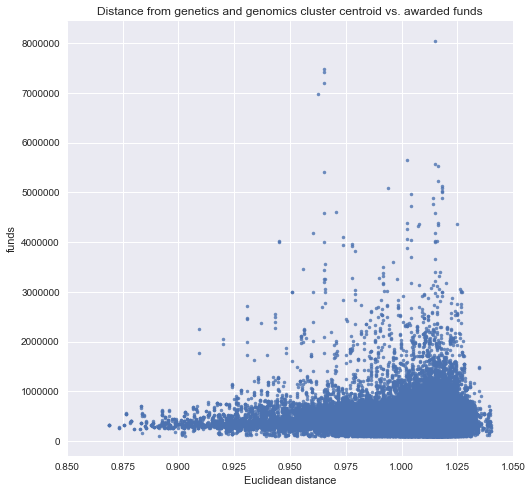

In [187]:
fig, ax = plt.subplots()
fig.set_size_inches(8, 8)
_ = sns.regplot('dist_18', 'funds', data = df_modeling, 
                fit_reg = False, marker = '.')
_ = plt.title('Distance from genetics and genomics cluster centroid vs. awarded funds')
_ = plt.xlabel('Euclidean distance')
_ = plt.xlim(0.85, 1.05)

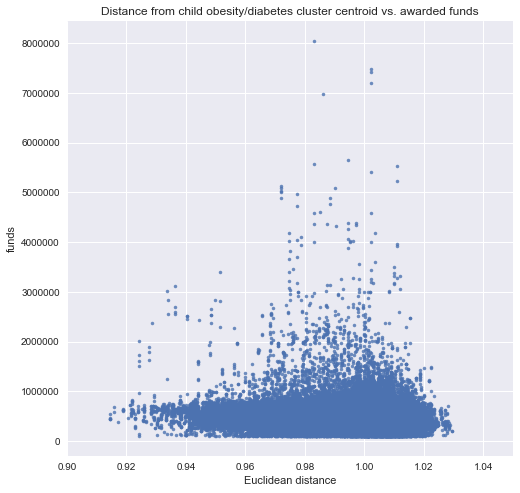

In [182]:
fig, ax = plt.subplots()
fig.set_size_inches(8, 8)
_ = sns.regplot('dist_8', 'funds', data = df_modeling, 
                fit_reg = False, marker = '.')
_ = plt.title('Distance from child obesity/diabetes cluster centroid vs. awarded funds')
_ = plt.xlabel('Euclidean distance')
_ = plt.xlim(0.9, 1.05)

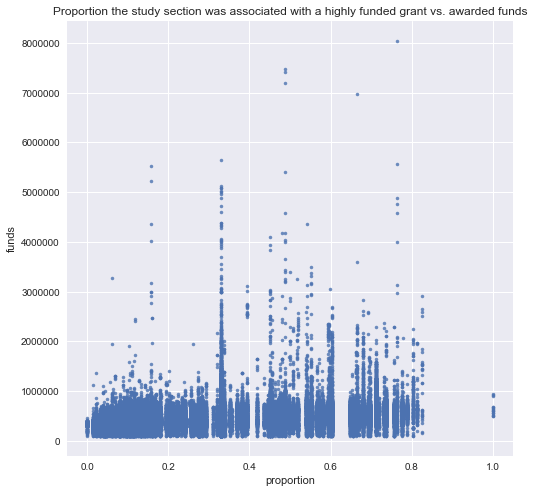

In [188]:
fig, ax = plt.subplots()
fig.set_size_inches(8, 8)
_ = sns.regplot('high_sect', 'funds', data = df_modeling, 
                fit_reg = False, marker = '.')
_ = plt.title('Proportion the study section was associated with a highly funded grant vs. awarded funds')
_ = plt.xlabel('proportion')

## Conclusions

Although the abstract alone can lead to better than random predictions of how many funds a grant was awarded, combining abstract information with other data about the grant results in relatively good predictive power. Our final model was a random forest trained on these data. Although we can determine which features random forests used to split the data, and therefore which variables were deemed important, it is more difficult to determine how the feature corresponds to our response. We do know that the study section the grant was assigned to as well as the associated organization seem to have a large effect on ultimately how many funds the grant is awarded.

Our model is based on only a static snapshot of NIH grants, specifically from grants funded between 2008 and 2016 and would need to be re-trained as more grants are funded. This is particularly true of the unsupervised clustering we performed; in fact, we could possibly get better predictions by fitting more clusters, although the increase in dimensionality may make model training more difficult. 

Although grant information is available from as early as 1985, as of 2017/05/09 when the data was downloaded abstracts were only available from 2008 and later. As of 2017/06 it seems the NIH may have updated these earlier grants to include abstracts and to fix DUNS numbers. It would be interesting to investigate these earlier grants and see if grant funding and abstracts have changed over time.